In [1]:
# clear the workspace, removing any objects that could be in the memory
try:
    from IPython import get_ipython
    get_ipython().magic('clear')
    get_ipython().magic('reset -f')
except:
    pass

In [2]:
# import the necessary packages

import numpy as np

import pandas as pd

import matplotlib.pyplot as plt

import seaborn as sns

import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

from sklearn.decomposition import PCA
from sklearn.preprocessing import scale, normalize
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, precision_score, recall_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import Normalizer
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [3]:
%matplotlib inline

In [4]:
# load the dataset onto an on-memory dataframe

df = pd.read_csv('../../../data/bank_churn_analysis/Churn_Modelling.csv')

## Exploratory Analysis

In [5]:
df.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [6]:
df.columns

Index(['RowNumber', 'CustomerId', 'Surname', 'CreditScore', 'Geography',
       'Gender', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary', 'Exited'],
      dtype='object')

In [7]:
df.shape

(10000, 14)

In [8]:
df.isna().sum()

RowNumber          0
CustomerId         0
Surname            0
CreditScore        0
Geography          0
Gender             0
Age                0
Tenure             0
Balance            0
NumOfProducts      0
HasCrCard          0
IsActiveMember     0
EstimatedSalary    0
Exited             0
dtype: int64

It is almost a miracle that the data I obtained has no issues with missing data

In [9]:
df['EstimatedSalary'].describe()

count     10000.000000
mean     100090.239881
std       57510.492818
min          11.580000
25%       51002.110000
50%      100193.915000
75%      149388.247500
max      199992.480000
Name: EstimatedSalary, dtype: float64

In [10]:
df.dtypes

RowNumber            int64
CustomerId           int64
Surname             object
CreditScore          int64
Geography           object
Gender              object
Age                  int64
Tenure               int64
Balance            float64
NumOfProducts        int64
HasCrCard            int64
IsActiveMember       int64
EstimatedSalary    float64
Exited               int64
dtype: object

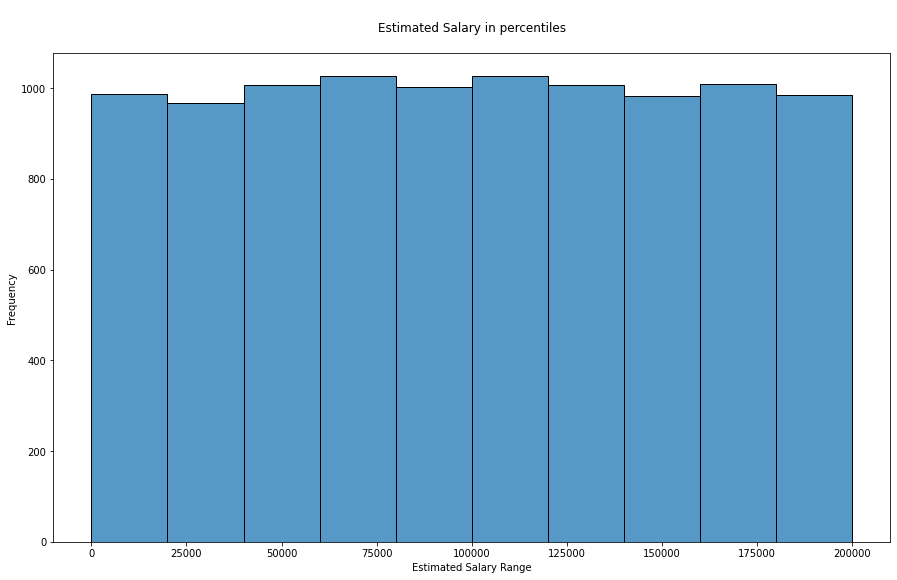

In [11]:
plt.figure(figsize=(15, 9))
sns.histplot(df, x='EstimatedSalary', bins=10);
plt.title('\nEstimated Salary in percentiles\n');
plt.xlabel('Estimated Salary Range');
plt.ylabel('Frequency');

In [12]:
df['Geography'].unique()

array(['France', 'Spain', 'Germany'], dtype=object)

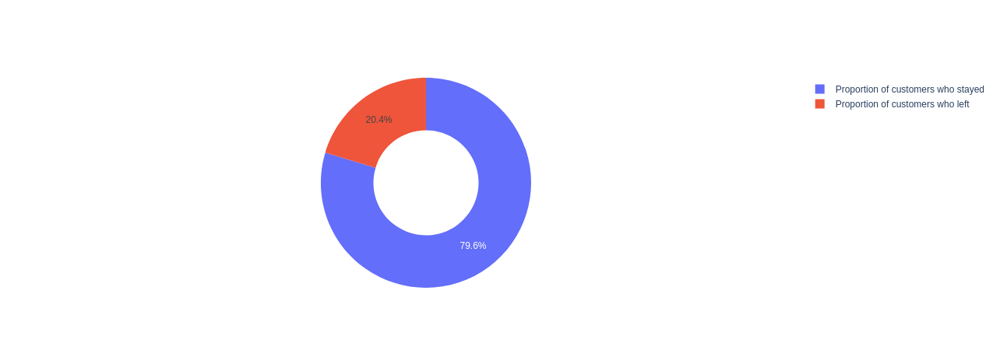

In [13]:
left = df[df['Exited']==1].shape[0]
stayed = df[df['Exited']==0].shape[0]
churn_percentage = go.Figure(data=[go.Pie(labels=['Proportion of customers who left', 'Proportion of customers who stayed'], values=[left, stayed], hole=.5)])
iplot(churn_percentage)

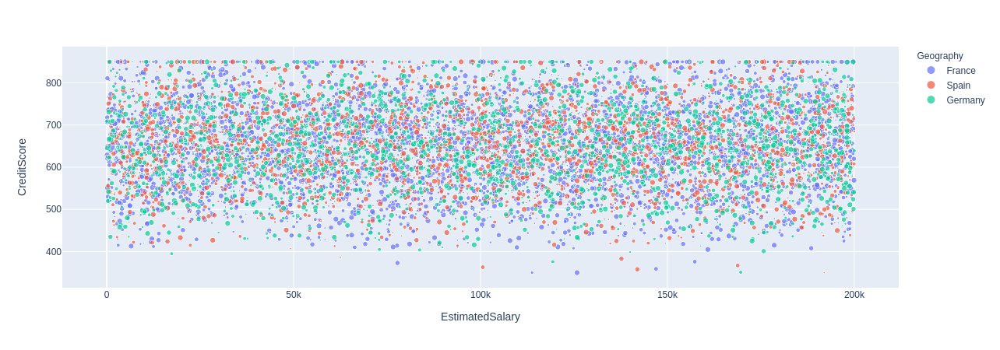

In [14]:
fig = px.scatter(df, x='EstimatedSalary', y='CreditScore', size='Tenure', color='Geography', hover_name='Surname', log_x=False, size_max=5)
fig.show()

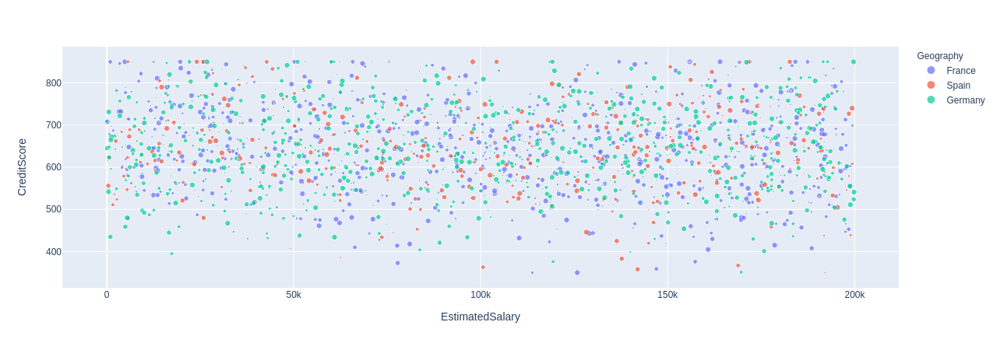

In [15]:
churn_fig = px.scatter(df[df['Exited']==1], x='EstimatedSalary', y='CreditScore', size='Tenure', color='Geography', hover_name='Surname', log_x=False, size_max=5)
churn_fig.show()

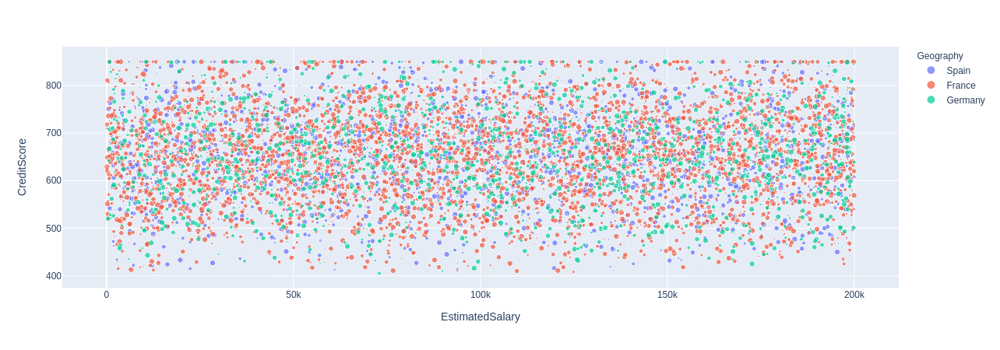

In [16]:
not_churn_fig = px.scatter(df[df['Exited']==0], x='EstimatedSalary', y='CreditScore', size='Tenure', color='Geography', hover_name='Surname', log_x=False, size_max=5)
not_churn_fig.show()

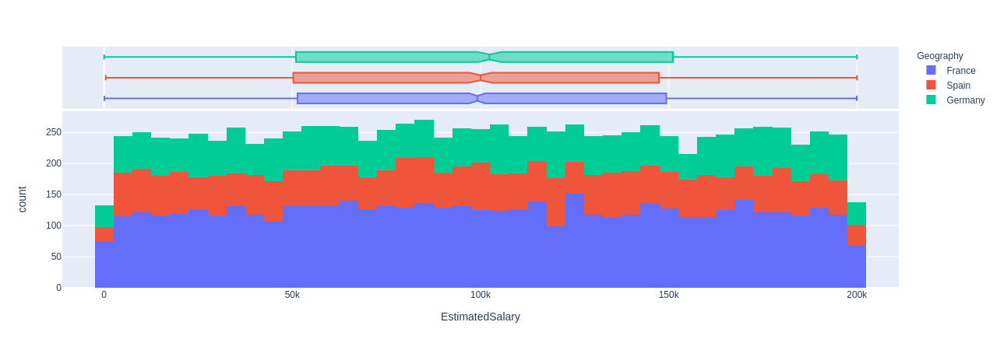

In [17]:
histogram_fig = px.histogram(df, x='EstimatedSalary', color='Geography', marginal='box', hover_data=df.columns)
histogram_fig.show()

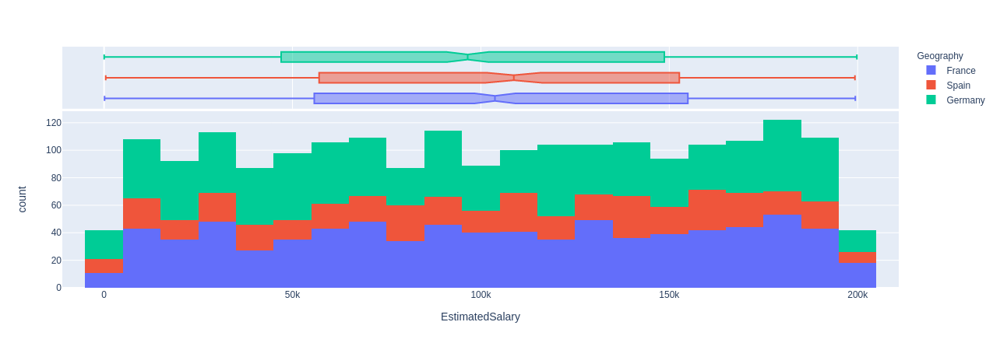

In [18]:
churn_histogram_fig = px.histogram(df[df['Exited']==1], x='EstimatedSalary', color='Geography', marginal='box', hover_data=df.columns)
churn_histogram_fig.show()

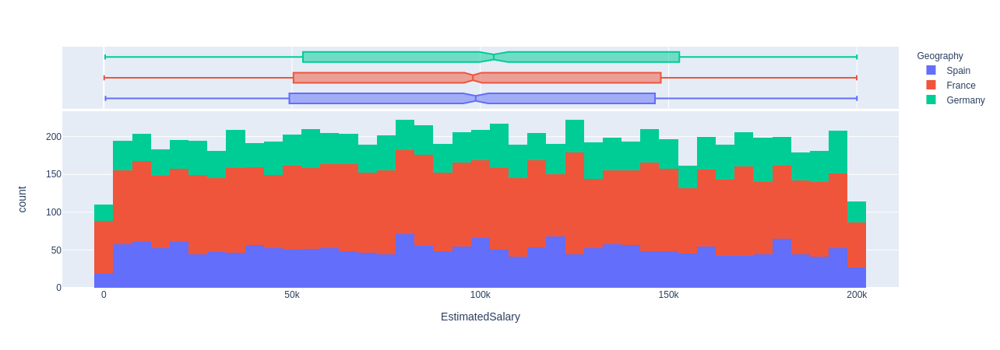

In [19]:
not_churn_histogram_fig = px.histogram(df[df['Exited']==0], x='EstimatedSalary', color='Geography', marginal='box', hover_data=df.columns)
not_churn_histogram_fig.show()

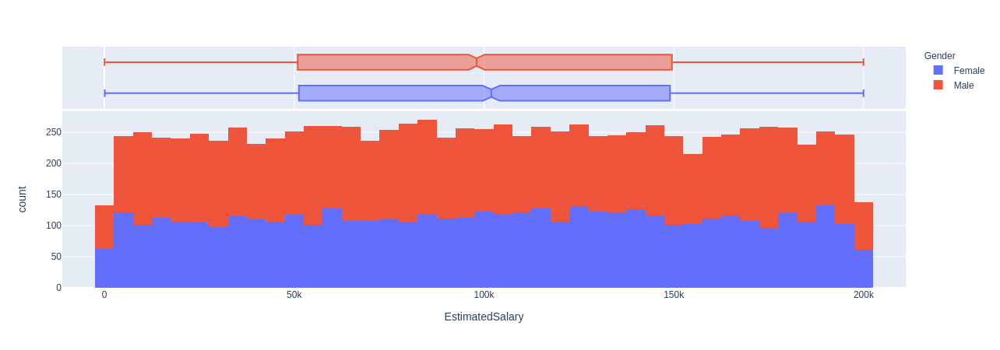

In [20]:
gender_hist = px.histogram(df, x='EstimatedSalary', color='Gender', marginal='box', hover_data=df.columns)
gender_hist.show()

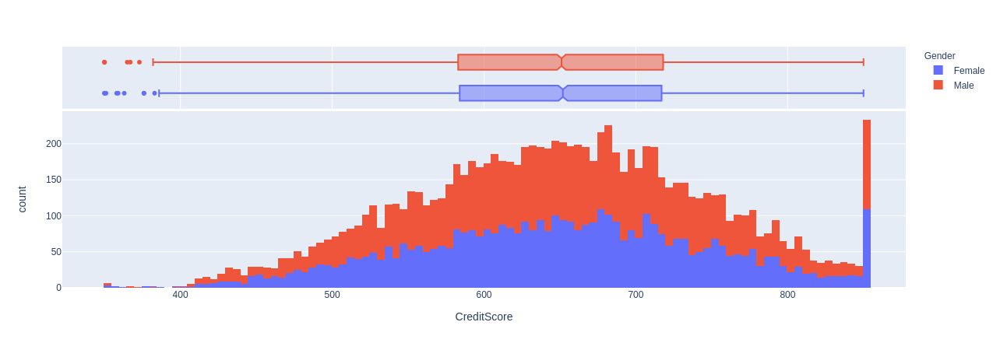

In [21]:
credit_score_hist = px.histogram(df, x='CreditScore', color='Gender', marginal='box', hover_data=df.columns)
credit_score_hist.show()

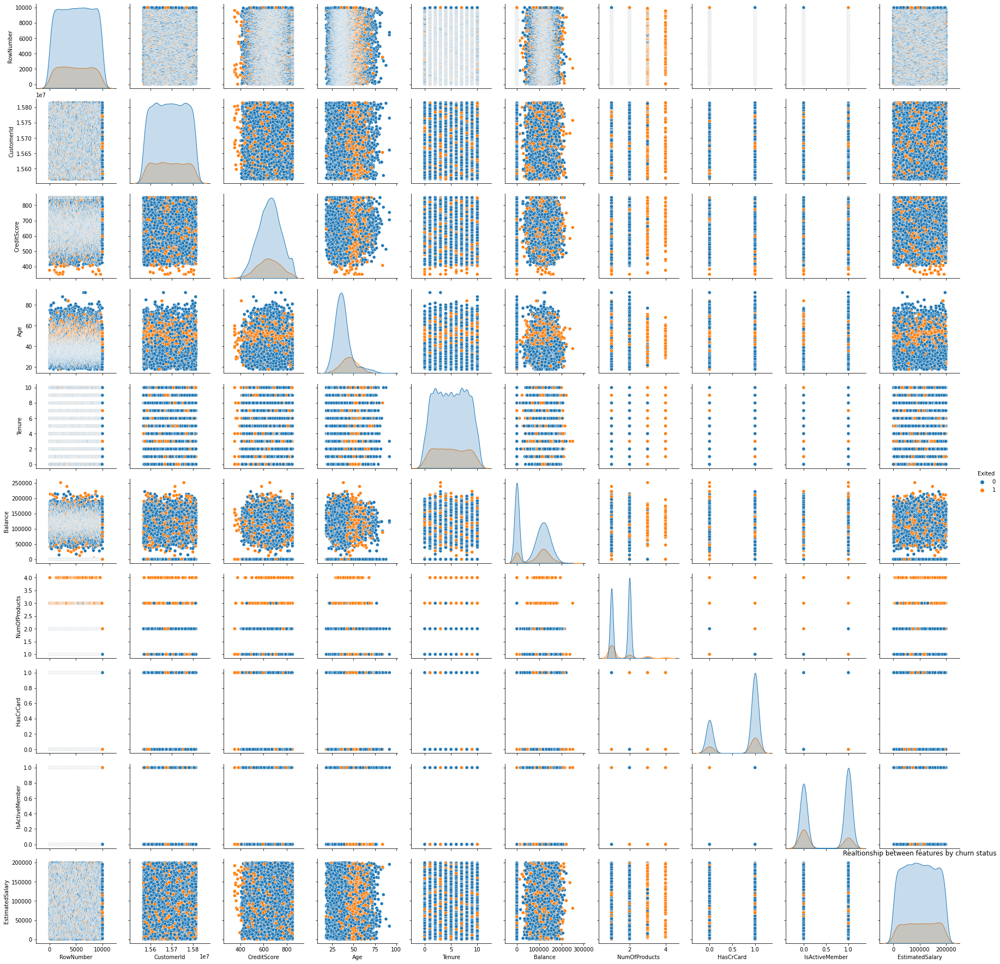

In [22]:
sns.pairplot(df, hue='Exited', kind='scatter');

In [23]:
df.dtypes

RowNumber            int64
CustomerId           int64
Surname             object
CreditScore          int64
Geography           object
Gender              object
Age                  int64
Tenure               int64
Balance            float64
NumOfProducts        int64
HasCrCard            int64
IsActiveMember       int64
EstimatedSalary    float64
Exited               int64
dtype: object

### DATA CLEANUP
#### ISSUES

1. Some columns do not add any value to the data. These include;
    - Surname -> contains too many unique values to be considered. And names are 
    - CustomerId -> this is a random number that only acts as a primary key of the data. Any coincidental correlation could throw the classifier off.
    - RowNumber -> also uniquely idenfies each customer record
2. Some columns are represented as strings, instead of numbers. These include;
    - Geography
    - Gender
    
#### RESOLUTION PLAN

1. Create a new dataframe that excludes Surname, CustomerId and RowNumber
2. In the new dataframe, create new columns that use numerical encodings for the two columns(Geography and Gender)

In [24]:
#we start by creating a new dataframe that does not include the three columns to be dropped

In [25]:
clean_df = df.drop(['Surname', 'CustomerId', 'RowNumber'], axis=1)

In [26]:
#test and confirm that indeed the three columns have been dropped
clean_df.columns

Index(['CreditScore', 'Geography', 'Gender', 'Age', 'Tenure', 'Balance',
       'NumOfProducts', 'HasCrCard', 'IsActiveMember', 'EstimatedSalary',
       'Exited'],
      dtype='object')

In [27]:
#The second resolution plan involves encoding the columns (Geography, Gender) to numerical values, to be able to pass them into the classifier

In [28]:
#only columns of type 'category' can be encoded, so we need to convert the data types first, then encode them into numerical values
clean_df['Geography'] = clean_df['Geography'].astype('category')
clean_df['Geography'] = clean_df['Geography'].cat.codes

In [29]:
clean_df['Gender'] = clean_df['Gender'].astype('category')
clean_df['Gender'] = clean_df['Gender'].cat.codes

In [30]:
#print a few lines to see that our data looks much cleaner now
clean_df.head()

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,619,0,0,42,2,0.00,1,1,1,101348.88,1
1,608,2,0,41,1,83807.86,1,0,1,112542.58,0
2,502,0,0,42,8,159660.80,3,1,0,113931.57,1
3,699,0,0,39,1,0.00,2,0,0,93826.63,0
4,850,2,0,43,2,125510.82,1,1,1,79084.10,0


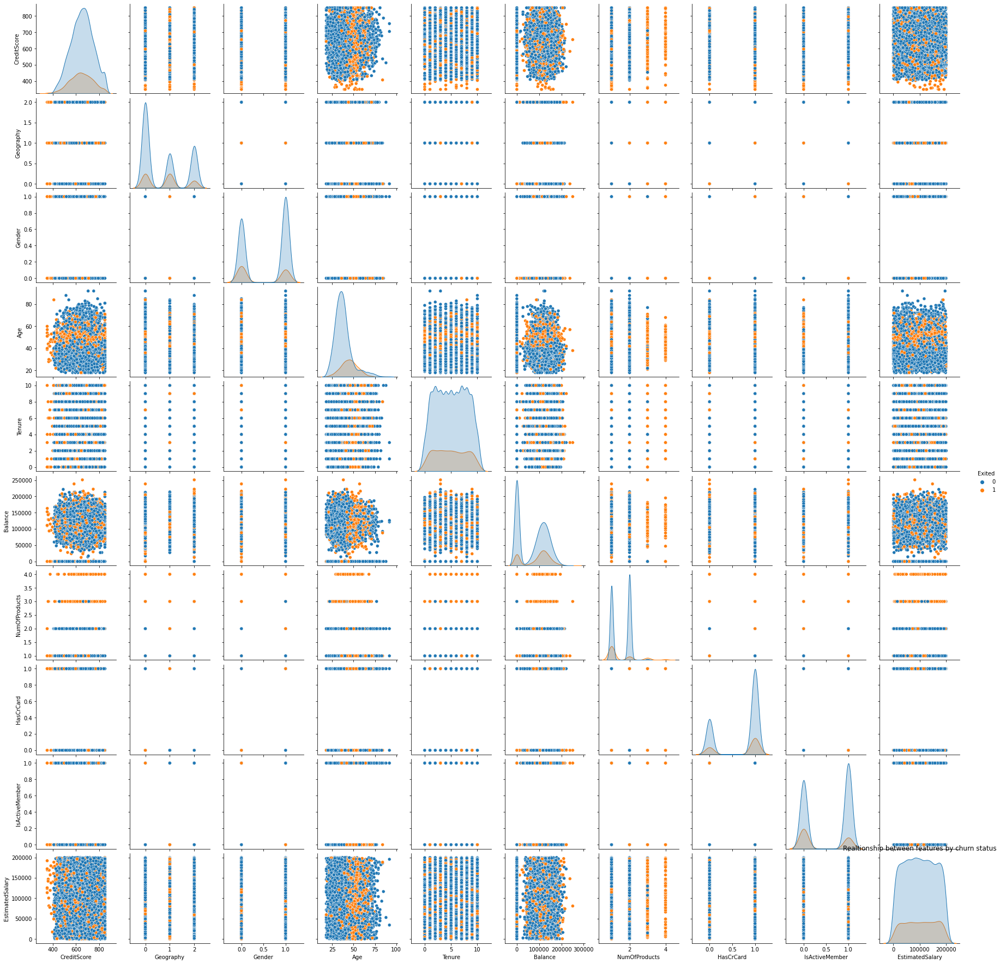

In [31]:
#display the pairplot again to see if there is any change from the initial plot
sns.pairplot(clean_df, hue='Exited');

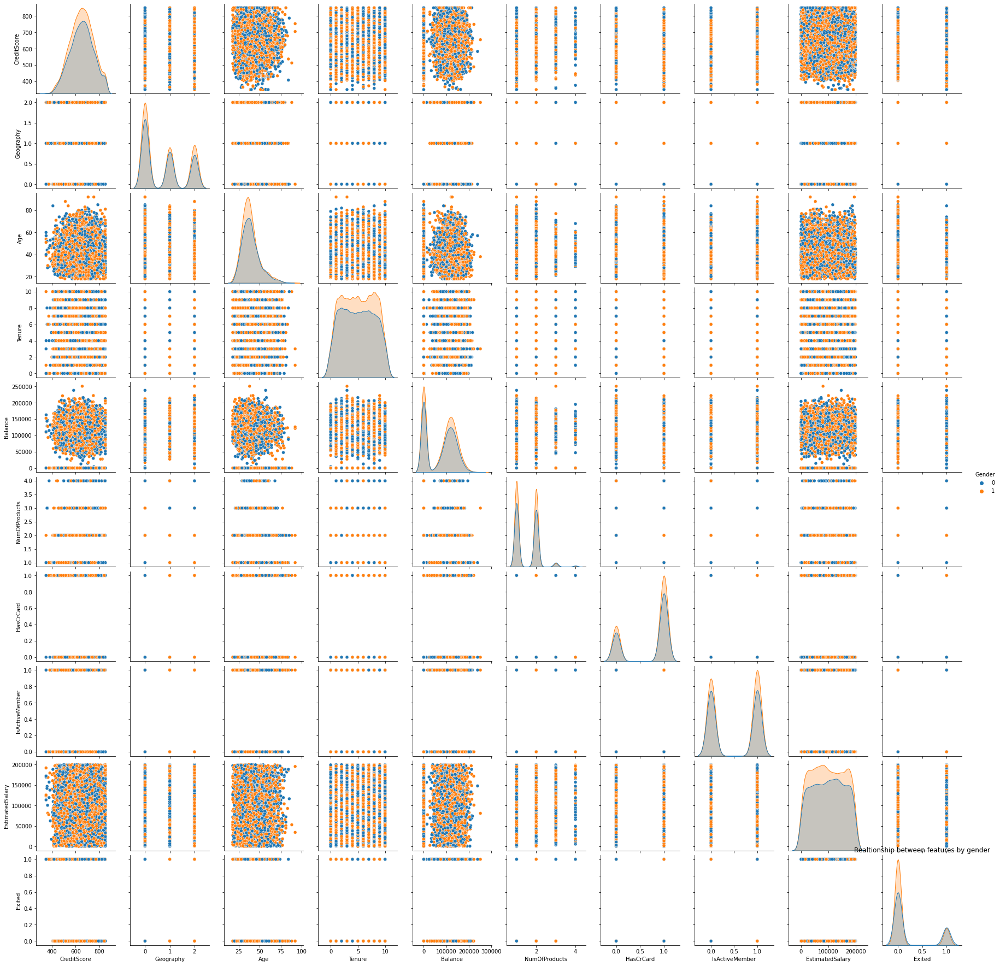

In [32]:
#display the pairplot again to see if there is any change from the initial plot
sns.pairplot(clean_df, hue='Gender', kind='scatter');

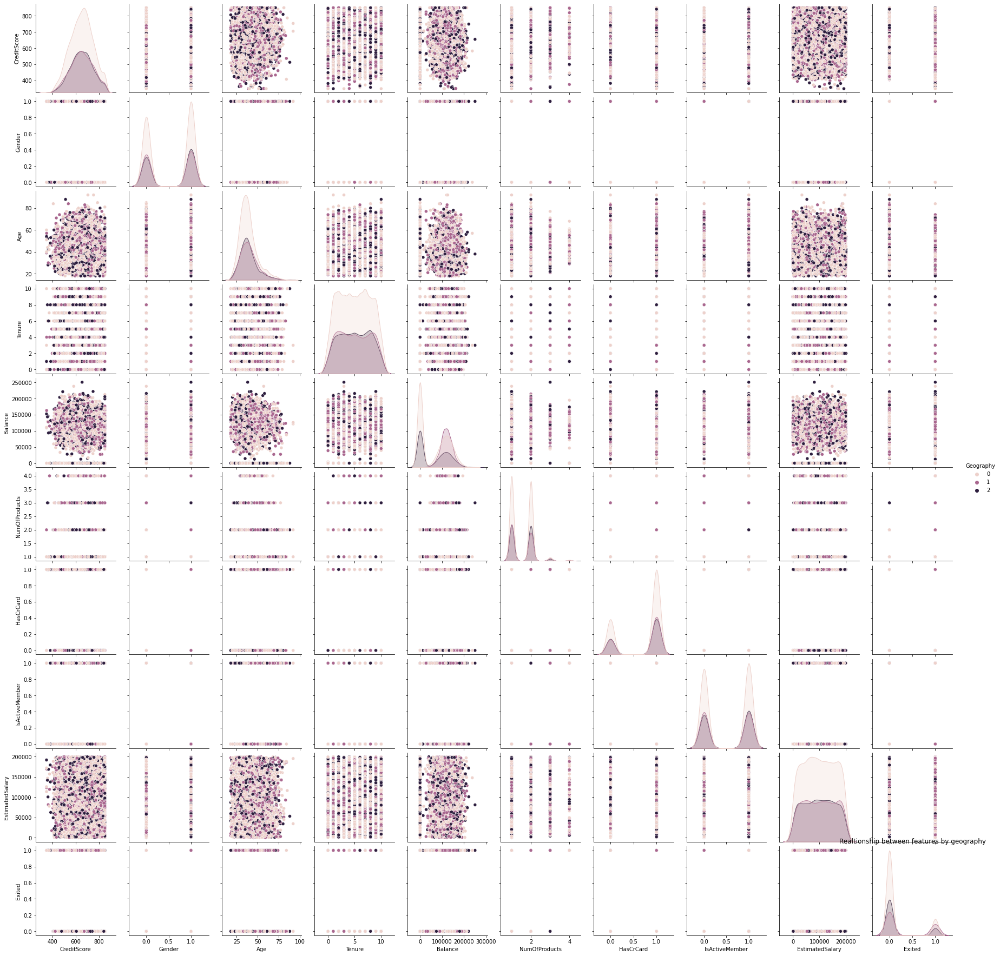

In [33]:
#display the pairplot again to see if there is any change from the initial plot
sns.pairplot(clean_df, hue='Geography', kind='scatter');

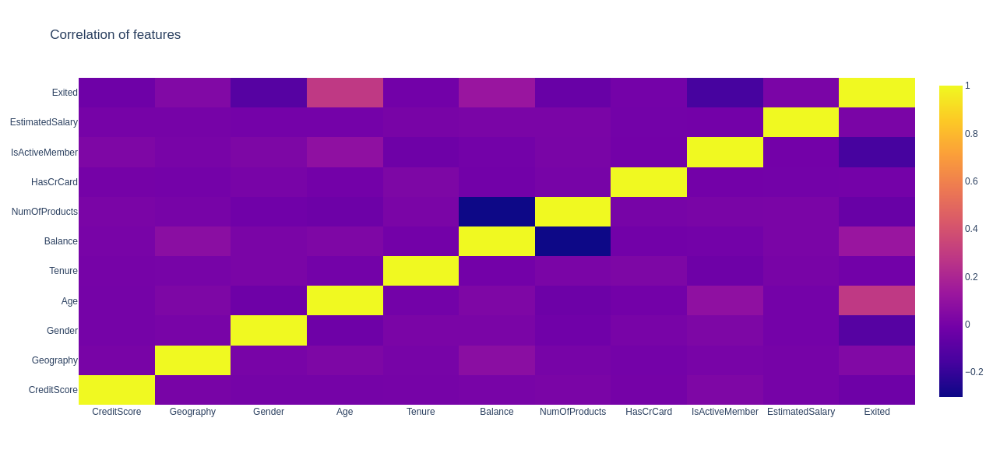

In [34]:
heatmap = go.Figure(data=go.Heatmap(
                   z=clean_df.corr(),
                   x=clean_df.columns,
                   y=clean_df.columns,
                   hoverongaps = False),
                   layout = dict(title='Correlation of features',height=600, width=1200))
heatmap.show()

## MODELLING

In [35]:
#We need to separate the fetures from the target variable
x = clean_df[[col for col in clean_df.columns if col != 'Exited']]
y = clean_df['Exited']

In [36]:
#split the data into portions; one to be used for training and the other for testing
X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=0.20, random_state=42)

In [37]:
#We build a K-Nearest Neighbor object. I like to use the smallest number of nearest neighbor possible, to see how it performs
knn = KNeighborsClassifier(n_neighbors=1)

In [38]:
knn.fit(X_train, Y_train)

KNeighborsClassifier(n_neighbors=1)

In [39]:
knn_pred = knn.predict(X_test)

In [40]:
print(accuracy_score(knn_pred, Y_test))

0.6865


In [41]:
print(precision_score(knn_pred, Y_test))

0.19338422391857507


In [42]:
print(recall_score(knn_pred, Y_test))

0.19689119170984457


In [43]:
print(confusion_matrix(knn_pred, Y_test))

[[1297  317]
 [ 310   76]]


## OPTIMIZATION

The 68% accuracy is not very good. What can be done to improve the figure significantly? We try to answer this question in this section

In [44]:
#We will try by first scaling the data, basically mapping the features onto the same space. This eliminates perceived overimportance of some features.

scaler = StandardScaler()
scaler.fit(x)
transformed = scaler.transform(x)

In [45]:
X_train, X_test, Y_train, Y_test = train_test_split(transformed, y, test_size=0.20, random_state=42)

In [46]:
knn = KNeighborsClassifier(n_neighbors=1)

In [47]:
knn.fit(X_train, Y_train)

KNeighborsClassifier(n_neighbors=1)

In [48]:
knn_pred = knn.predict(X_test)

In [49]:
print(accuracy_score(knn_pred, Y_test))

0.804


Scaling the data imporoved our accuracy score from 68 to 80%. This is a significant improvement, and one that is very welcome.

Next, I will use the elbow method to compute the optimum value of k

In [50]:
#I build a list with the error rates seen when the values of k are chosen between 1 to 40.
#The error rate is calculated by training a KNN classifier for each value of k,and taking the mean of predicted values that are not the same as the expected target.

error_rate = []
for i in range(1, 40):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train, Y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != Y_test))

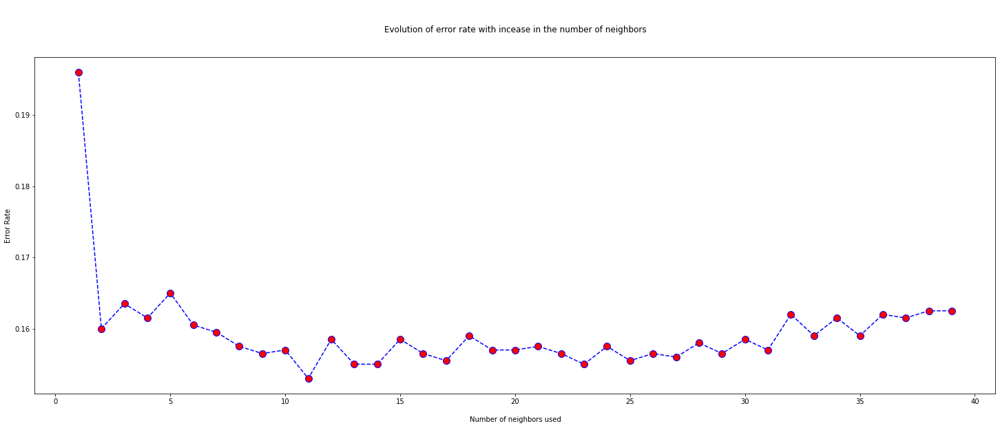

In [51]:
plt.figure(figsize=(25,9));
plt.plot(range(1, 40), error_rate, color='blue', marker='o', linestyle='dashed', markerfacecolor='red', markersize=10);
plt.title('\n\nEvolution of error rate with incease in the number of neighbors\n\n');
plt.xlabel('\nNumber of neighbors used');
plt.ylabel('Error Rate');

From the figure, it can be seen that a k value of 1 produced the highest error rate. This sugests that 1 is probalby the least optimal k value.
Although 11 is the global minimum in terms of error rates, the error rate is still bouncing a lot at that point. It is always good to wait for the graph to stabilize before choosing the best value. For this reason, I chose 23 for two reasons;

1. It is an odd number; and hence the classifier will always return a class prediction.
2. It has a pretty low error rate, and it seems the graph has stabilized at that point.

In [52]:
#Having chosen 23 as the optimal k value, I will perform modelling again to see how the performance improves.

In [53]:
knn = KNeighborsClassifier(n_neighbors=23)
knn.fit(X_train, Y_train)
knn_pred = knn.predict(X_test)

In [54]:
print(accuracy_score(knn_pred, Y_test))

0.845


In [55]:
print(precision_score(knn_pred, Y_test))

0.27989821882951654


In [56]:
print(recall_score(knn_pred, Y_test))

0.8029197080291971


In [57]:
print(confusion_matrix(knn_pred, Y_test))

[[1580  283]
 [  27  110]]


Choosing a different value of k brought significant improvement again. This time the accuracy jumped to 84.5%.

A further optimization step that I think would be helpful is performing principal component analysis.

In [58]:
normalizer = Normalizer()
normalizer.fit(clean_df.drop(['Exited'], axis=1))
normalized = normalizer.transform(clean_df.drop(['Exited'], axis=1))

In [59]:
pca = PCA(n_components=2)

In [60]:
pca.fit(normalized)
x_pca = pca.transform(normalized)

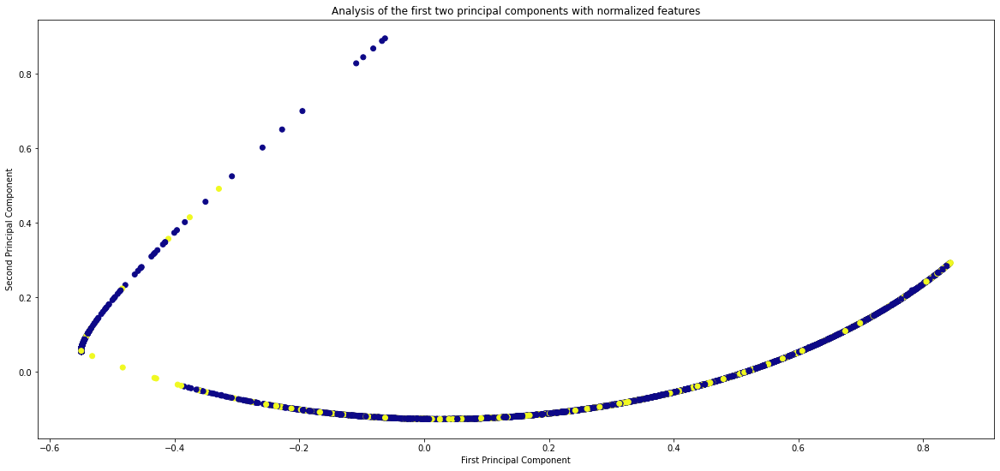

In [61]:
plt.figure(figsize=(20, 9));
plt.scatter(x_pca[:,0], x_pca[:, 1], c=y, cmap='plasma');
plt.title('Analysis of the first two principal components with normalized features');
plt.xlabel('First Principal Component');
plt.ylabel('Second Principal Component');

In [62]:
scaler = StandardScaler()
scaler.fit(clean_df.drop(['Exited'], axis=1))
scaled = scaler.transform(clean_df.drop(['Exited'], axis=1))

In [63]:
pca = PCA(n_components=2)

In [64]:
pca.fit(scaled)
x_pca = pca.transform(scaled)

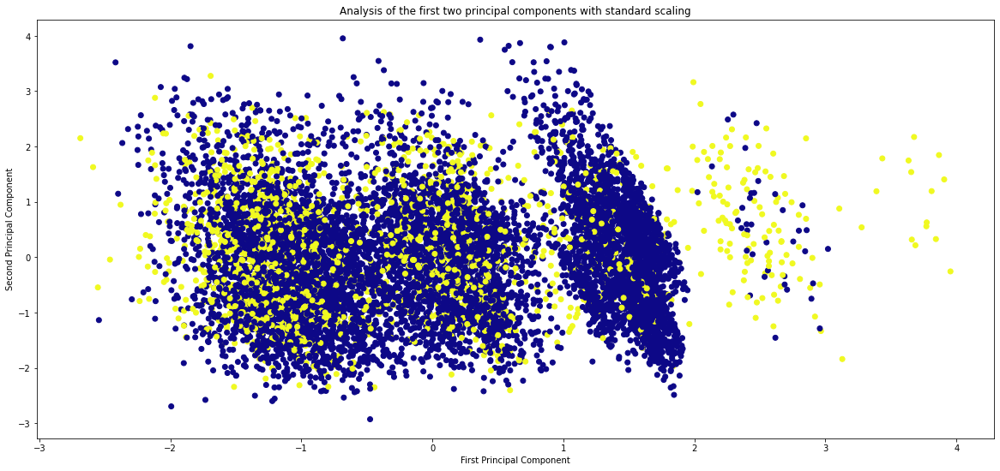

In [65]:
plt.figure(figsize=(20, 9));
plt.scatter(x_pca[:,0], x_pca[:,1], c=y, cmap='plasma');
plt.title('Analysis of the first two principal components with standard scaling');
plt.xlabel('First Principal Component');
plt.ylabel('Second Principal Component');

In [66]:
pca.components_

array([[ 0.00933865, -0.15376762, -0.06018966, -0.13867442,  0.05948528,
        -0.69651274,  0.67969504,  0.05121809, -0.00882821,  0.0077361 ],
       [ 0.17294881,  0.14293025, -0.08930512,  0.59879591, -0.27504297,
        -0.08105446,  0.11047205, -0.20495775,  0.65955714, -0.10808268]])

In [67]:
components_df = pd.DataFrame(pca.components_, columns=x.columns)

In [68]:
components_df

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary
0,0.009339,-0.153768,-0.060190,-0.138674,0.059485,-0.696513,0.679695,0.051218,-0.008828,0.007736
1,0.172949,0.142930,-0.089305,0.598796,-0.275043,-0.081054,0.110472,-0.204958,0.659557,-0.108083


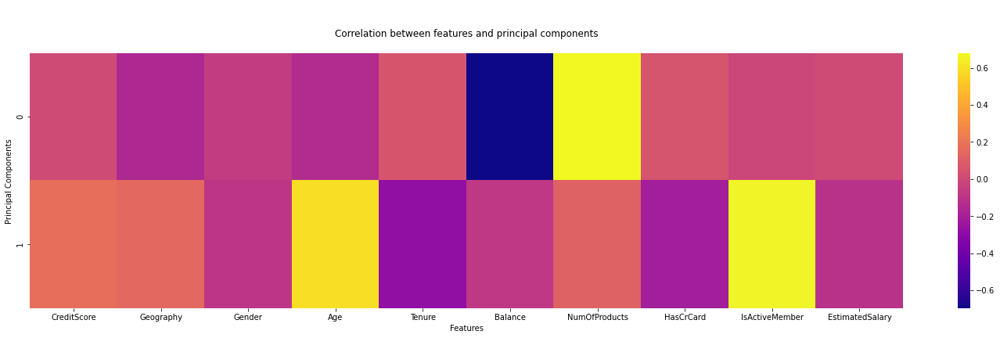

In [69]:
plt.figure(figsize=(25, 6));
sns.heatmap(components_df, cmap='plasma');
plt.title('\n\nCorrelation between features and principal components\n');
plt.xlabel('Features');
plt.ylabel('Principal Components');

In [70]:
print(pca.explained_variance_ratio_)

[0.1320624  0.11029644]


The first two principal components do not explain a significant proportion of variability in the data. For this reason, I do not think it would be a good idea to build a pipeline with PCA and KNN in this case.

## RESULTS

The model that will calssify a customer into either the churn group, or non-churn group.

The 84.5% accuracy achieved means that (almost) 9 out of 10 times, the model will classify correctly